# Trabajo Práctico N°2 - Filtrado lineal óptimo
## Autores


#### Para este trabajo práctico se deberá modelar la respuesta al impulso h(n) de un sistema parlante-habitación-micrófono con identificación de sistemas, asumiendo régimen estacionario.

### Liberías utilizadas

In [51]:
import numpy as np
from scipy import linalg
from scipy import signal as sp
from IPython.display import Image
from scipy.io.wavfile import read
import struct
import matplotlib.pyplot as plt
import IPython.display as ipd
import librosa
import sounddevice as sd

### Funciones auxiliares

In [52]:
def get_graphs(sound,fs, record,fs_record,title):
    
    
    freqs_sound, Rsound = sp.welch(sound, fs=fs, window='hamming', nperseg=2048)
    freqs_record, Rrecord = sp.welch(record, fs=fs_record, window='hamming', nperseg=2048)
    
    fig, ax = plt.subplots(3, 2, figsize=(18, 15))
    fig.suptitle( title, fontsize=20)
    
    #Excitaciones 
    ax[0][0].plot(sound)
    ax[0][0].set_ylabel('$x_j(n)$', fontsize=16)
    ax[0][0].set_xlabel('$n$', fontsize=16)
    ax[0][0].set_title('Señal $x_j(n)$', fontsize=18)
    ax[0][0].grid()
    
    ax[1][0].semilogy(freqs_sound, Rsound)
    ax[1][0].set_ylabel('$R_{xx}(f)$', fontsize=16)
    ax[1][0].set_xlabel('$f[Hz]$', fontsize=16)
    ax[1][0].set_title('Espectro de potencia de $x_j(n)$', fontsize=18)
    ax[1][0].grid()
    
 
    ax[2][0].specgram(sound, Fs=fs)
    ax[2][0].set_title('Espectrograma de $x_j(n)$', fontsize=18)
    ax[2][0].set_xlabel('$t$ [s]', fontsize=16)
    ax[2][0].set_ylabel('$f$ [Hz]', fontsize=16)

    #Señales 
    ax[0][1].plot(record)
    ax[0][1].set_ylabel('$y_j(n)$', fontsize=16)
    ax[0][1].set_xlabel('$n$', fontsize=16)
    ax[0][1].set_title('Señal $y_j(n)$', fontsize=18)
    ax[0][1].grid()
    
    ax[1][1].semilogy(freqs_record, Rrecord)
    ax[1][1].set_ylabel('$R_{yy}(f)$', fontsize=16)
    ax[1][1].set_xlabel('$f[Hz]$', fontsize=16)
    ax[1][1].set_title('Espectro de potencia de $y_j(n)$', fontsize=18)
    ax[1][1].grid()
    
 
    ax[2][1].specgram(record, Fs=fs_record)
    ax[2][1].set_title('Espectrograma de $y_j(n)$', fontsize=18)
    ax[2][1].set_xlabel('$t$ [s]', fontsize=16)
    ax[2][1].set_ylabel('$f$ [Hz]', fontsize=16)
    
    plt.tight_layout()
    plt.show()
    

### Parámetros

In [53]:
# frequency is the number of times a wave repeats a second

fs = 48e3

num_samples = 480000
# Se utiliza una frecuencia de muestreo de 48KHz al ser la nativa de las placas de audio.
sampling_rate = 48000.0
amplitude = 32000 #Usamos la amplitud maxima disponible
time_frame=10
nframes=48000
comptype="NONE"
#Manipulamos los archivos en formato wav pero al no usar ningun tipo de compresion trabajamos con los datos originales
compname="not compressed"
nchannels=1
sampwidth=2
#configuracion de audio
sd.default.samplerate = int(sampling_rate)
sd.default.channels = 2


## 1. Señales de trabajo
Para obtener la mejor estimación posible es necesario trabajar con una señal que tenga el mayor rango de frecuencias posibles. Esto se debe a no se podrá estimar el comportamiento del sistema en aquellos rango donde no haya contenido espectral, ya que no se podrá obtener ninguna correlación entre la señal de entrada y la señal deseada.

### 1.1 Señal de voz - $x_1(n)$
Considerando la gráfica presentada anteriormente se usará como señal de voz la de un ([discurso](https://www.youtube.com/watch?v=NiKtZgImdlY)). Eventualmente se investigará la conveniencia de usar un tipo de voz en particular según los valores obtenidos  para lograr optimizar una banda en particular.

Señal entrante

In [54]:
fs, x_speech = read('../PASA-TP2/audio/x_speech.wav')
print(f'Sample rate: {fs}, Audio length: {x_speech.shape[0]/fs} seconds')
ipd.Audio(x_speech, rate=fs)

Sample rate: 48000, Audio length: 10.006520833333333 seconds


C:\Users\jtori\AppData\Local\Temp\ipykernel_11752\1645920676.py:1: WavFileWarning: Chunk (non-data) not understood, skipping it.
  fs, x_speech = read('../PASA-TP2/audio/x_speech.wav')


(0.0, 480313.0)

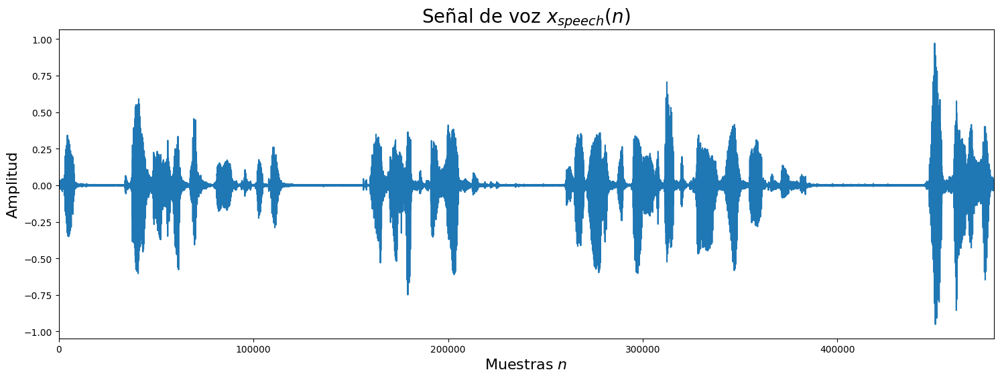

In [55]:
plt.figure(figsize=(18, 6))
plt.plot(x_speech)
#plt.grid()
plt.title('Señal de voz $x_{speech}(n)$', fontsize=20)
plt.xlabel('Muestras $n$', fontsize=16)
plt.ylabel('Amplitud', fontsize=16)
plt.xlim(0, len(x_speech))

Señal grabada

In [56]:
fs, y_speech = read('../PASA-TP2/audio/y_speechfloat.wav')
print(f'Sample rate: {fs}, Audio length: {y_speech.shape[0]/fs} seconds')
ipd.Audio(y_speech, rate=fs)

Sample rate: 48000, Audio length: 10.006520833333333 seconds


C:\Users\jtori\AppData\Local\Temp\ipykernel_11752\4146131046.py:1: WavFileWarning: Chunk (non-data) not understood, skipping it.
  fs, y_speech = read('../PASA-TP2/audio/y_speechfloat.wav')


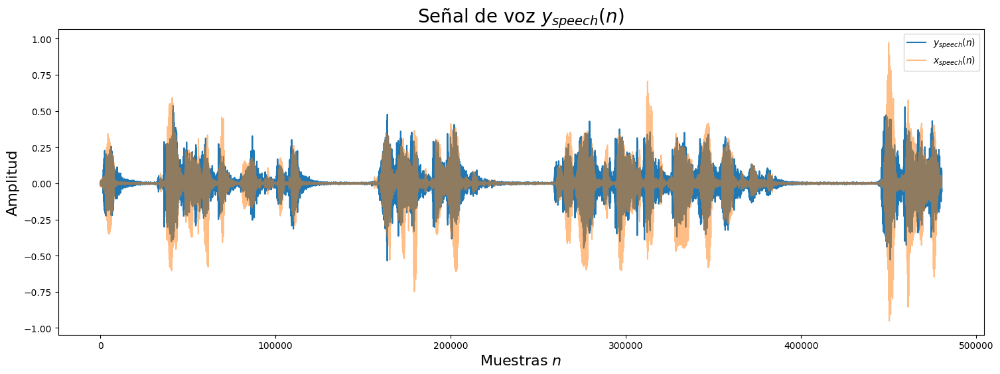

In [57]:
plt.figure(figsize=(18, 6))

plt.plot(y_speech,label='$y_{speech}(n)$')
plt.plot(x_speech, alpha=0.5, label='$x_{speech}(n)$')
#plt.grid()
plt.title('Señal de voz $y_{speech}(n)$', fontsize=20)
plt.xlabel('Muestras $n$', fontsize=16)
plt.ylabel('Amplitud', fontsize=16)
plt.legend()

#### Graficamos la señal en el tiempo, su espectro de potencia y espectograma

Grafico las excitaciones $x_j(n)$ en el tiempo, su espectro de potencia y espectrograma y los comparo con sus equivalentes en la señal grabada $y_j(n)$.

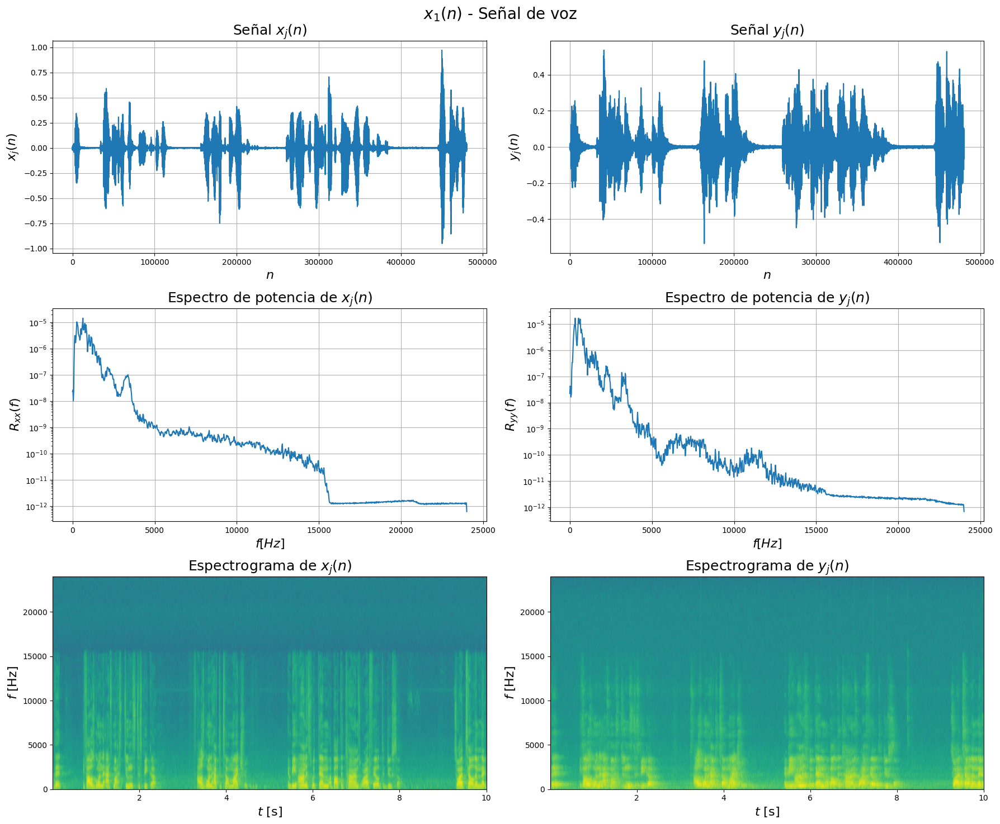

In [58]:
get_graphs(x_speech, sampling_rate,y_speech, sampling_rate,'$x_1(n)$ - Señal de voz')

### 1.2 Señal de música $x_1(n)$
Se realizó un análisis para ver que señal de origen musical tiene el mayor rango dinámico en el espectro audible, de manera de realizar las mejores mediciones. Según la imagen presente a continuación ([paper](https://www.researchgate.net/publication/293822323_Dynamic_Range_Across_Music_Genres_and_the_Perception_of_Dynamic_Compression_in_Hearing-Impaired_Listeners)), se observa que por debajo de una voz dando un discurso, el género musical con mayor riqueza de espectro es la música de cámara y la orquesta. Sin conocer todavía la forma aproximada que puede tener la respuesta al impulso de la habitación a medir se decide utilizar una muestra de música de orquesta. Adicionalmente, como un recurso extra se utilizará también una muestra de música de piano, por producir un espectro más homógeneo.

In [59]:
Image(url="Dynamic-range-comparison-between-different-music-genres-and-speech-across-frequency-The.png", width=600, height=900)

Consiguientemente se seleccionó un fragmento de la novena sinfonía de Beethoven descargada desde este [link](https://archive.org/details/onclassical-quality-wav-audio-files-of-classical-music/onclassical_demo_roccato_anonymous-roccato_riflessi_small-version.wav) en formato wav para preservar la mayor calidad posible. Para la muestra de piano se uso un fragmento del Waltz Op.54-1 en formato wav , descargado de este [link](https://ia802200.us.archive.org/4/items/abc-tube-hi-fi-piano-wav/04.%20Waltz%20Op.54-1.wav).

#### 9° Sinfonía de Beethoven
**Muestra**
Señal de música

In [60]:
fs, x_music = read('../PASA-TP2/audio/B9S.wav')
print(f'Sample rate: {fs}, Audio length: {x_music.shape[0]/fs} seconds')
ipd.Audio(x_music, rate=fs)

Sample rate: 48000, Audio length: 10.016979166666667 seconds


Señal grabada

In [61]:
fs, y_music = read('../PASA-TP2/audio/y_B9Sbis.wav')
print(f'Sample rate: {fs}, Audio length: {y_music.shape[0]/fs} seconds')
ipd.Audio(y_music, rate=fs)

Sample rate: 48000, Audio length: 10.016979166666667 seconds


C:\Users\jtori\AppData\Local\Temp\ipykernel_11752\812504699.py:1: WavFileWarning: Chunk (non-data) not understood, skipping it.
  fs, y_music = read('../PASA-TP2/audio/y_B9Sbis.wav')


#### Graficamos la señal en el tiempo, su espectro de potencia y espectograma

Grafico las excitaciones $x_j(n)$ en el tiempo, su espectro de potencia y espectrograma y los comparo con sus equivalentes en la señal grabada $y_j(n)$.

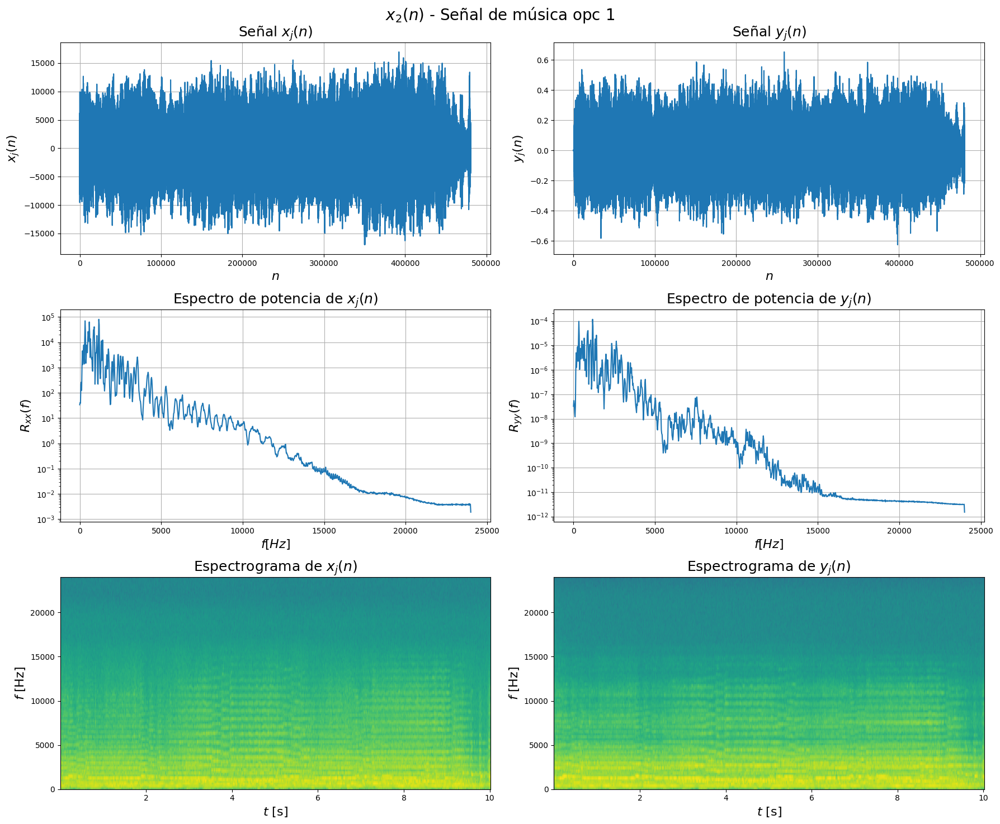

In [62]:
get_graphs(x_music, sampling_rate,y_music, sampling_rate,'$x_2(n)$ - Señal de música opc 1 ')

#### Waltz Op.54-1
**Muestra**
Señal 

In [63]:
fs, x_music2 = read('../PASA-TP2/audio/x_04Waltz.wav')
print(f'Sample rate: {fs}, Audio length: {x_music2.shape[0]/fs} seconds')
ipd.Audio(x_music2, rate=fs)

Sample rate: 48000, Audio length: 10.011208333333334 seconds


C:\Users\jtori\AppData\Local\Temp\ipykernel_11752\1017866582.py:1: WavFileWarning: Chunk (non-data) not understood, skipping it.
  fs, x_music2 = read('../PASA-TP2/audio/x_04Waltz.wav')


Señal Grabada

In [64]:
fs, y_music2 = read('../PASA-TP2/audio/y_04Waltz.wav')
print(f'Sample rate: {fs}, Audio length: {y_music2.shape[0]/fs} seconds')
ipd.Audio(y_music2, rate=fs)

Sample rate: 48000, Audio length: 10.0065 seconds


C:\Users\jtori\AppData\Local\Temp\ipykernel_11752\1006538329.py:1: WavFileWarning: Chunk (non-data) not understood, skipping it.
  fs, y_music2 = read('../PASA-TP2/audio/y_04Waltz.wav')


#### Graficamos la señal en el tiempo, su espectro de potencia y espectograma

Grafico las excitaciones $x_j(n)$ en el tiempo, su espectro de potencia y espectrograma y los comparo con sus equivalentes en la señal grabada $y_j(n)$.

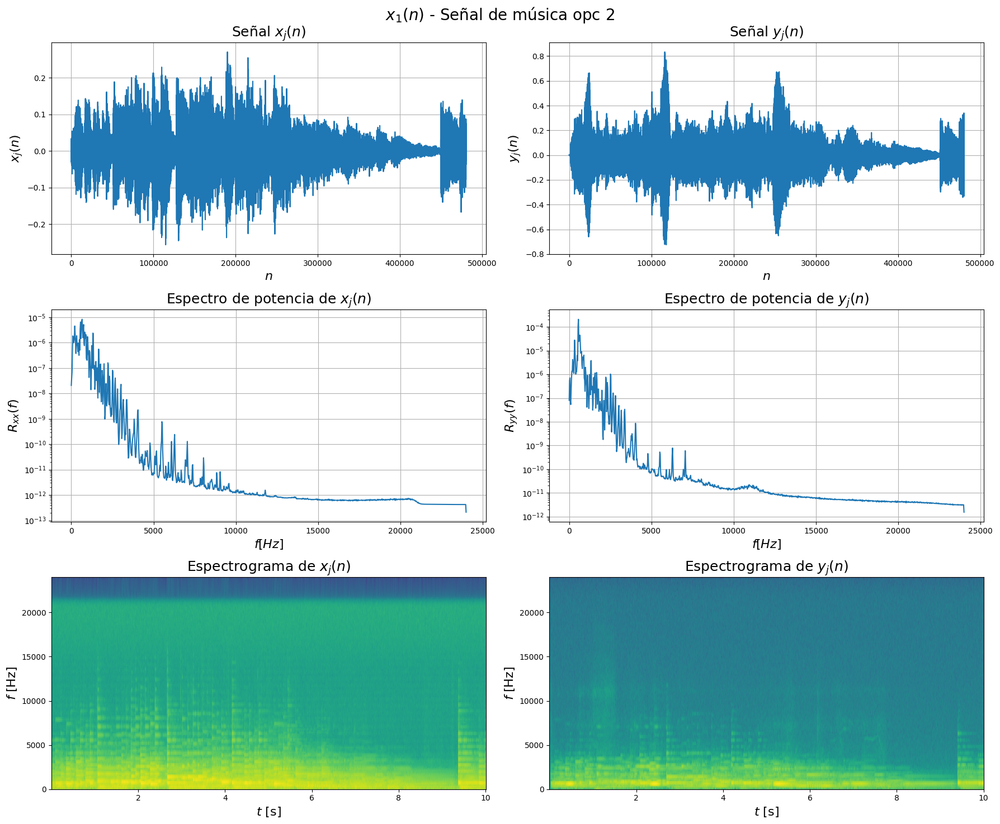

In [65]:
get_graphs(x_music2, sampling_rate,y_music2, sampling_rate,'$x_1(n)$ - Señal de música opc 2 ')

### 1.3 Señal cuadrada f=100 Hz
**Señal**

In [66]:
fs, x_square = read('../PASA-TP2/audio/prueba_square.wav')
print(f'Sample rate: {fs}, Audio length: {x_square.shape[0]/fs} seconds')
ipd.Audio(x_square, rate=fs)

Sample rate: 48000, Audio length: 10.0 seconds


Señal grabada

In [67]:
fs, y_square = read('../PASA-TP2/audio/y_square_wavebis.wav')
print(f'Sample rate: {fs}, Audio length: {y_square.shape[0]/fs} seconds')
ipd.Audio(y_square, rate=fs)

Sample rate: 48000, Audio length: 10.016979166666667 seconds


C:\Users\jtori\AppData\Local\Temp\ipykernel_11752\3452698037.py:1: WavFileWarning: Chunk (non-data) not understood, skipping it.
  fs, y_square = read('../PASA-TP2/audio/y_square_wavebis.wav')


### Comparación


d:\dev\PASA-TP2\.venv\Lib\site-packages\matplotlib\axes\_axes.py:8283: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


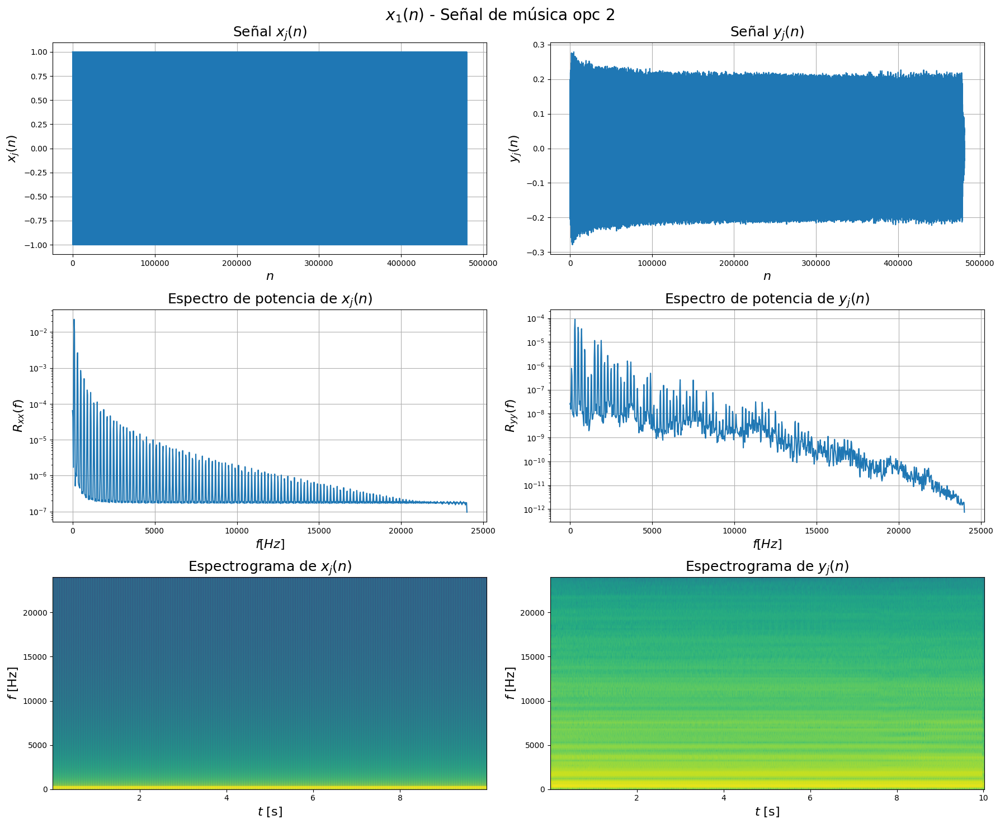

In [68]:
get_graphs(x_square, sampling_rate,y_square, sampling_rate,'$x_1(n)$ - Señal de música opc 2 ')

## Linear swept 
### $f_1=20Hz$ y $f_2=20KHZ$
### Señal

In [69]:
fs, x_linear_sweep = read('../PASA-TP2/audio/x_linear_sweep.wav')
print(f'Sample rate: {fs}, Audio length: {x_linear_sweep.shape[0]/fs} seconds')
ipd.Audio(x_linear_sweep, rate=fs)

Sample rate: 48000, Audio length: 10.0 seconds


### Señal grabada

In [70]:
fs, y_linear_sweep = read('../PASA-TP2/audio/y_linear_sweep.wav')
print(f'Sample rate: {fs}, Audio length: {y_linear_sweep.shape[0]/fs} seconds')
ipd.Audio(y_linear_sweep, rate=fs)

Sample rate: 48000, Audio length: 11.8 seconds


### Comparación

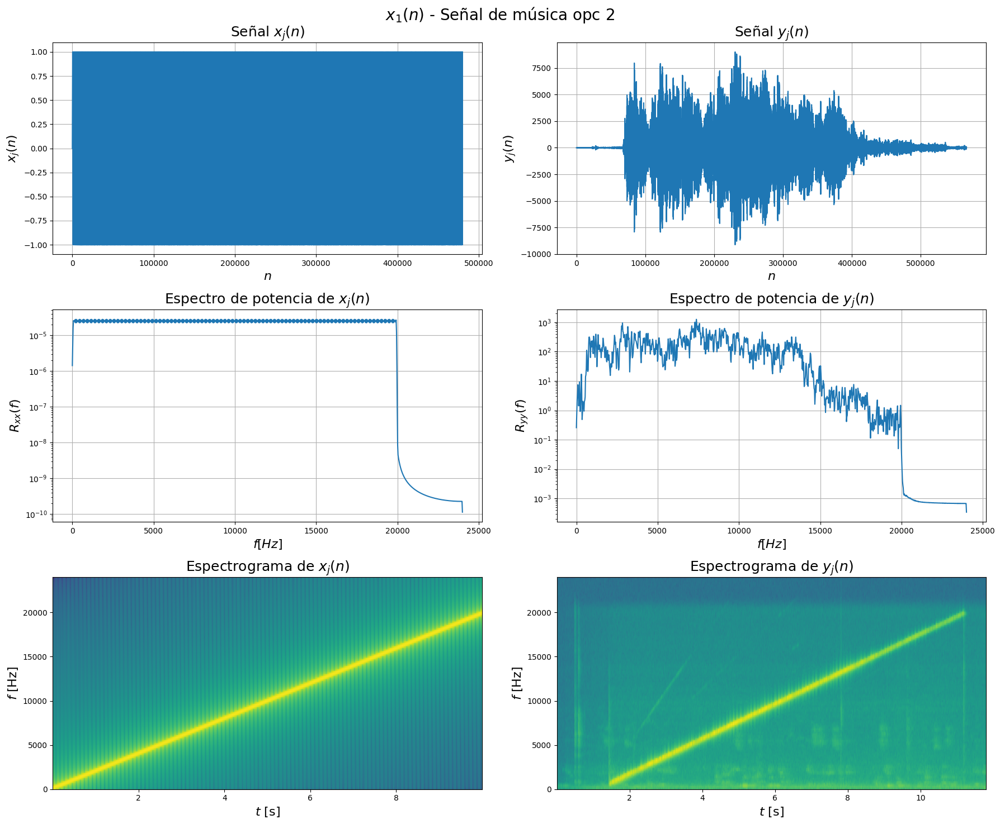

In [71]:
get_graphs(x_linear_sweep, sampling_rate,y_linear_sweep, sampling_rate,'$x_1(n)$ - Señal de música opc 2 ')

## Exponential swept
### $f_1=20Hz$ y $f_2=20KHZ$
### Muestra

In [72]:
fs, x_exp_swept = read('../PASA-TP2/audio/exponential_sweep.wav')
print(f'Sample rate: {fs}, Audio length: {x_exp_swept.shape[0]/fs} seconds')
ipd.Audio(x_exp_swept, rate=fs)

Sample rate: 48000, Audio length: 10.0 seconds


### Grabación

In [73]:
fs, y_exp_sweep = read('../PASA-TP2/audio/y_exp_sweep.wav')
print(f'Sample rate: {fs}, Audio length: {y_exp_sweep.shape[0]/fs} seconds')
ipd.Audio(y_exp_sweep, rate=fs)

Sample rate: 48000, Audio length: 10.016979166666667 seconds


C:\Users\jtori\AppData\Local\Temp\ipykernel_11752\1074313110.py:1: WavFileWarning: Chunk (non-data) not understood, skipping it.
  fs, y_exp_sweep = read('../PASA-TP2/audio/y_exp_sweep.wav')


### Comparación

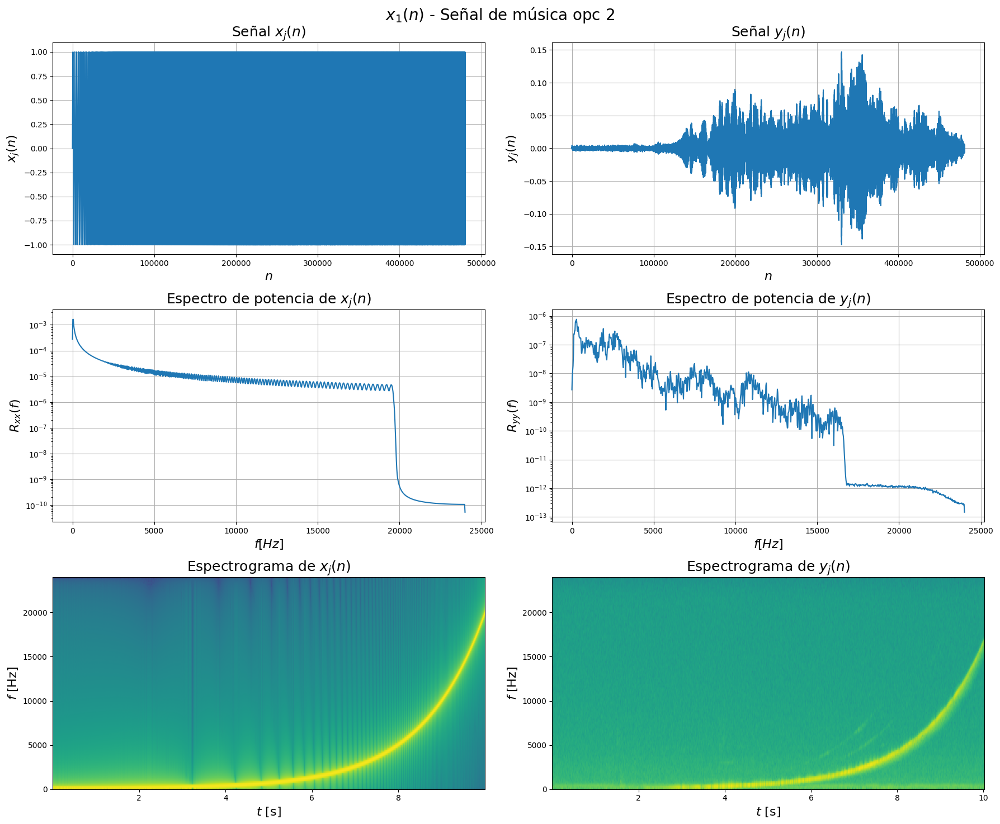

In [74]:
get_graphs(x_exp_swept, sampling_rate,y_exp_sweep, sampling_rate,'$x_1(n)$ - Señal de música opc 2 ')

## WGN
### N~(0,1)
### Muestra

In [75]:
fs, x_awgn = read('../PASA-TP2/audio/prueba_noise.wav')
print(f'Sample rate: {fs}, Audio length: {x_awgn.shape[0]/fs} seconds')
ipd.Audio(x_awgn, rate=fs)

Sample rate: 48000, Audio length: 10.0 seconds


### Grabación

In [76]:
fs, y_awgn = read('../PASA-TP2/audio/y_wgn_bis.wav')
print(f'Sample rate: {fs}, Audio length: {y_awgn.shape[0]/fs} seconds')
ipd.Audio(y_awgn, rate=fs)

Sample rate: 48000, Audio length: 10.0 seconds


### Comparación

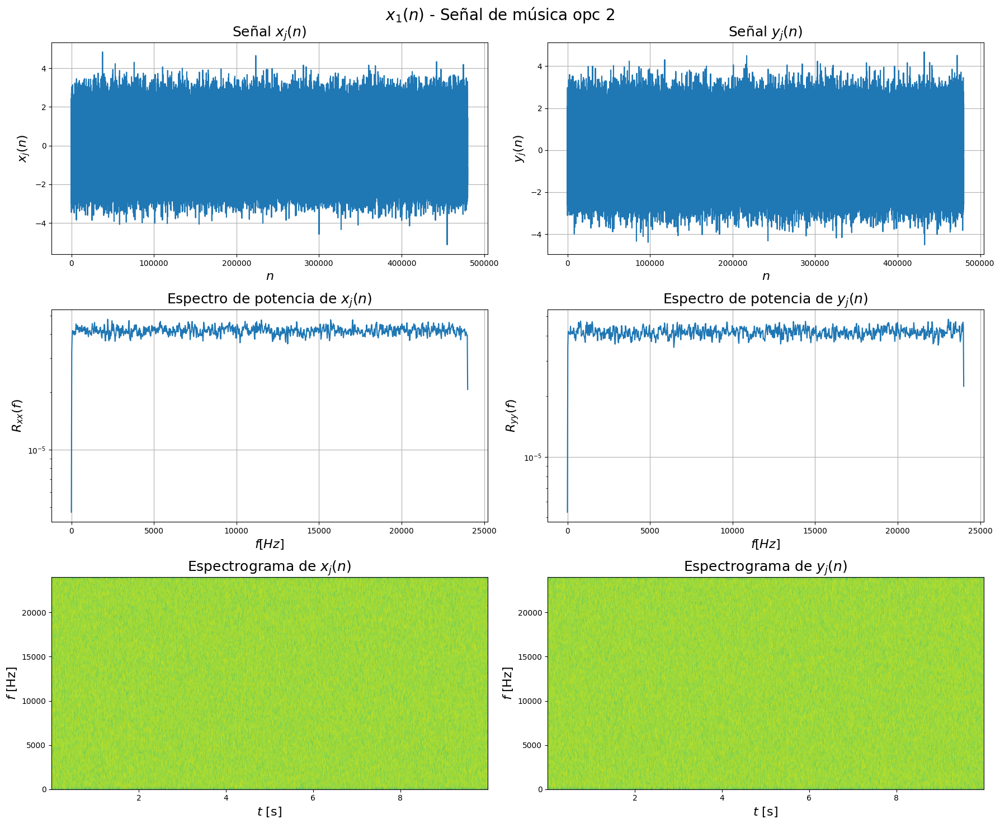

In [77]:
get_graphs(x_awgn, sampling_rate,y_awgn, sampling_rate,'$x_1(n)$ - Señal de música opc 2 ')

# Cálculo de M

In [78]:
def CalculateOptimumFilter(input_signal, desired_response, order = None, p = None, rxx = None):
    # Checks
    if (p is None) != (rxx is None):
        raise TypeError("p and R must be specified together")

    # Calculate the parameters if not provided
    if p is None and rxx is None:
        len_input = len(input_signal)
        desired_response = desired_response[:len_input]
        # Calculate the autocorrelation sequence p and crosscorrelation matrix using the toeplitz property
        rxx = sp.correlate(input_signal, input_signal,  method="fft") / len(input_signal)
        p = sp.correlate(desired_response, input_signal , method="fft") / len(input_signal)

        # Only keep the positive lag ends
        rxx = rxx[rxx.argmax():rxx.argmax()+order]
        p = p[len(p)//2:len(p)//2+order]
    
        # Truncate according to the filter order. Use max range of values if the order is not specified
        # if order is not None:
        #     p = p[:order+1]
        #     rxx = rxx[:order+1]

    R = linalg.toeplitz(rxx)
    wo = np.dot(linalg.inv(R), p)

    Jo = desired_response.var() - p.dot(wo)

    return wo, Jo

In [79]:
def find_delay(x, y):
    """
    Encuentra el delay entre dos señales usando correlación cruzada
    """
    # Calcula la correlación cruzada
    correlation = sp.correlate(y, x, method='fft')
    
    # Encuentra el índice del máximo
    delay_idx = np.argmax(np.abs(correlation))
    
    # Calcula el delay real (considerando que correlation tiene 2*len-1 puntos)
    delay = delay_idx - (len(x) - 1)
    
    return delay

# Ejemplo de uso
delay = find_delay(x_linear_sweep, y_linear_sweep)
print(f"Delay detectado: {delay} muestras ({delay/fs:.3f} segundos)")

# Alinea las señales
if delay > 0:
    x_aligned = x_linear_sweep[:-delay] if delay < len(x_linear_sweep) else []
    y_aligned = y_linear_sweep[delay:]
    print("x_aligned: ", x_aligned.shape)
else:
    x_aligned = x_linear_sweep[-delay:]
    y_aligned = y_linear_sweep[:delay] if delay < 0 else y_linear_sweep

Delay detectado: 56237 muestras (1.172 segundos)
x_aligned:  (423763,)


In [80]:

wo, Jo =CalculateOptimumFilter(x_linear_sweep[:len(y_linear_sweep[54700:-32000])], y_linear_sweep[54700:-32000], 500)
print("Costo mínimo: ", Jo)
print("coeficientes del filtro óptimo: ", wo)

Costo mínimo:  2806704.3308707546
coeficientes del filtro óptimo:  [ 7.36167133e-02 -3.01676273e-01  1.75821513e-01 -5.99869609e-01
  2.58699656e-01 -7.17221498e-01  2.84013152e-01 -4.23126578e-01
  1.68682098e-01  2.67147899e-01 -3.87806892e-02  1.08572030e+00
 -1.80656314e-01  1.50232756e+00  6.57982230e-02  1.60864890e+00
  7.22377837e-01  1.11769617e+00  1.13146579e+00  1.90958887e-01
  9.32282686e-01 -6.26683235e-01  1.21050268e-01 -8.87587667e-01
 -6.59960270e-01 -5.07397354e-01 -9.68700528e-01  1.45970881e-01
 -6.07402205e-01  5.52594781e-01  2.15232894e-01  5.71481824e-01
  9.38217342e-01  2.14936286e-01  6.88986123e-01 -5.38073301e-01
 -3.80780995e-01 -1.25786877e+00 -1.77355778e+00 -1.85637832e+00
 -2.75170898e+00 -2.10866404e+00 -2.45581007e+00 -1.56477785e+00
 -7.94845700e-01 -3.18232775e-02  1.55025220e+00  2.04045105e+00
  3.45357537e+00  3.57456040e+00  3.71265221e+00  3.33384776e+00
  1.87233257e+00  9.56437707e-01 -1.23847091e+00 -2.46370173e+00
 -3.92813826e+00 -4.827

In [81]:
def RunAnalysis(input, desired_response, max_order, num_points):
    x = input / np.max(input)
    y = desired_response / np.max(desired_response)
    plt.figure()
    plt.plot(x)
    plt.plot(y)
    
    print("tamaño x: ", x.shape)
    print("tamaño y: ", y.shape)
    
    max_M = max_order
    num_runs = num_points
    log_div = np.log10(max_M)/num_runs
    Ms = []
    for i in range(num_runs+1):
        Ms.append(int(10 ** (log_div*i)))
    print(Ms)
    num_runs = len(Ms)
    results = np.zeros(num_runs)
    final_w = []
    
    for i in range(num_runs):
        wo, Jo = CalculateOptimumFilter(x[:len(y)], y, Ms[i])
        results[i] = Jo/np.var(y)
        final_w.append(wo)
    
    t = np.linspace(0, 1/fs * len(y), len(y))
    fig, axs = plt.subplots(1, 2, figsize=(18, 5))
    
    axs[0].plot(Ms, results)
    axs[0].set_xlabel("Filter Order")
    axs[0].set_ylabel("MSE")
    axs[0].set_title("MSE vs Filter Order")
    axs[0].grid()
    
    axs[1].set_title("Final Coefficients")
    axs[1].set_xlabel("Wo Coefficients")
    axs[1].stem(final_w[results.argmin()], label="W coefficients")
    axs[1].legend()
    axs[1].grid()
    
    plt.tight_layout()
    plt.show()
    print("Minimum MSE: ", results.min(), " at M = ", Ms[results.argmin()])
    
    # H(w)
    H = np.fft.fft(final_w[results.argmin()])
    plt.figure()
    plt.plot(np.fft.fftshift(20*np.log10(np.abs(H))), label="H(w)")
    

(480000,)
(566400,)
(479700,)
tamaño x:  (480000,)
tamaño y:  (479700,)
[1, 1, 3, 6, 11, 21, 39, 73, 135, 251, 464, 857, 1584, 2928, 5411, 10000]


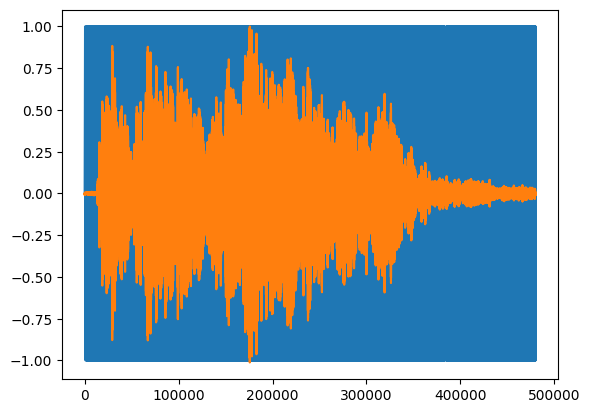

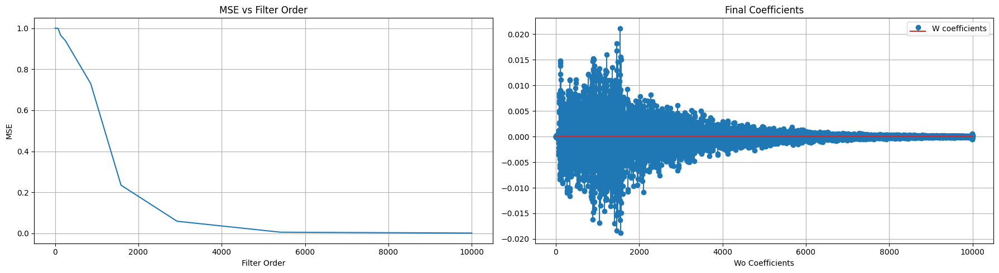

Minimum MSE:  0.0011508531887171108  at M =  10000


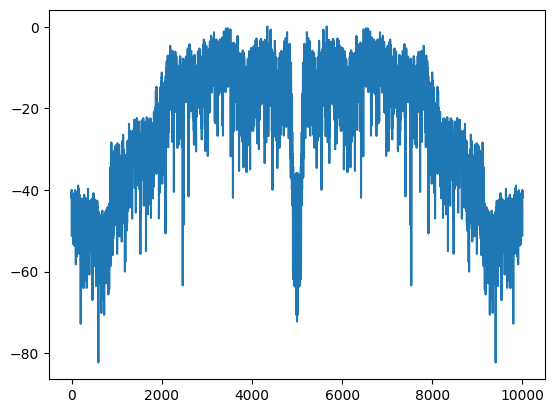

In [82]:
print(x_linear_sweep.shape)
print(y_linear_sweep.shape)
y = y_linear_sweep[54700:-32000]
print(y.shape)
RunAnalysis(x_linear_sweep, y, 10000, 15)

# Exponential Sweep

tamaño x:  (480000,)
tamaño y:  (472000,)
[1, 1, 2, 4, 7, 11, 19, 32, 52, 86, 141, 232, 380, 624, 1024, 1681, 2759, 4527, 7428, 12189, 20000]


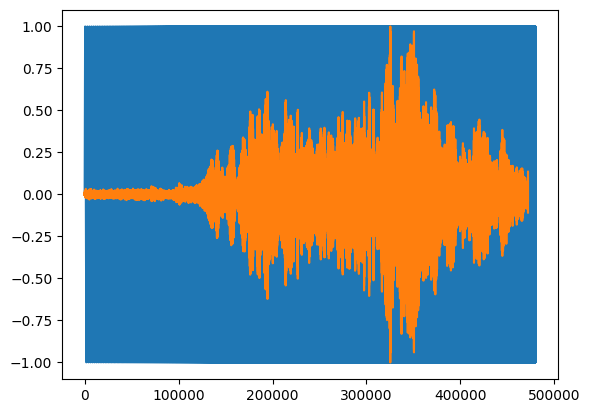

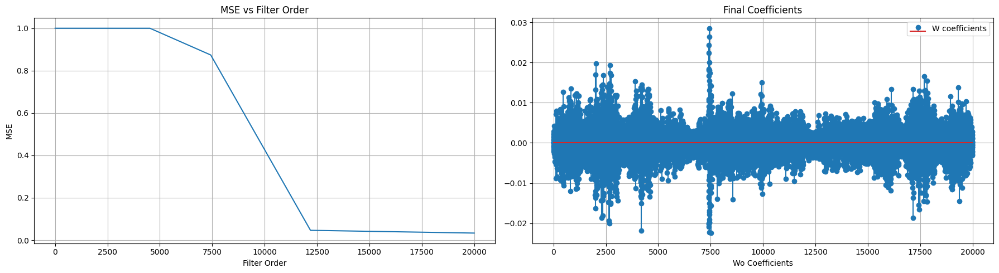

Minimum MSE:  0.033381130546331406  at M =  20000


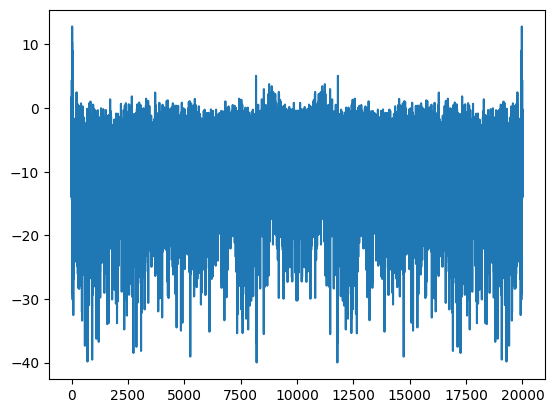

In [93]:
x = x_exp_swept
y = y_exp_sweep[:x_exp_swept.shape[0]]
y = y[5000:-3000]
RunAnalysis(x, y, 20000, 20)

# Speech Signal

tamaño x:  (480000,)
tamaño y:  (475000,)
[1, 1, 2, 4, 6, 11, 17, 28, 46, 75, 122, 198, 320, 518, 838, 1355, 2192, 3545, 5734, 9274, 15000]


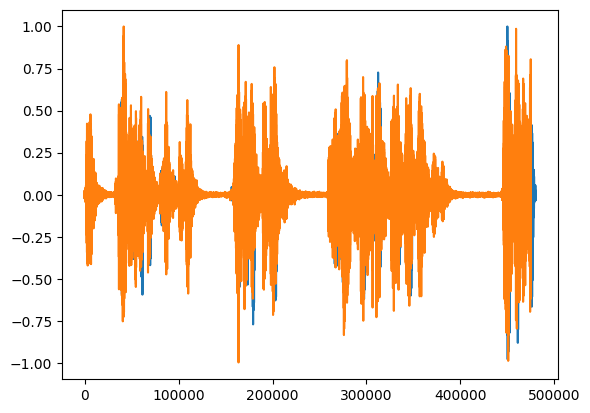

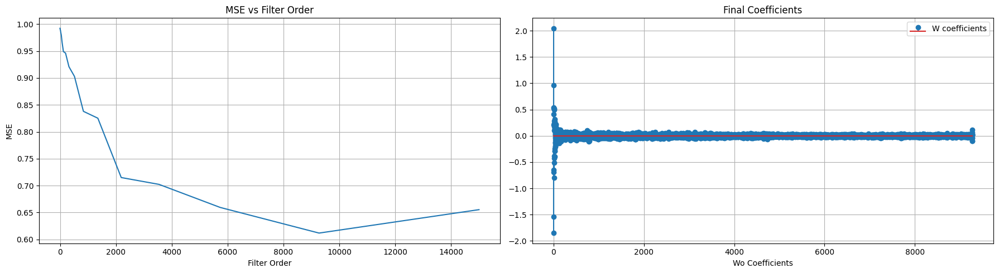

Minimum MSE:  0.6118285059928894  at M =  9274


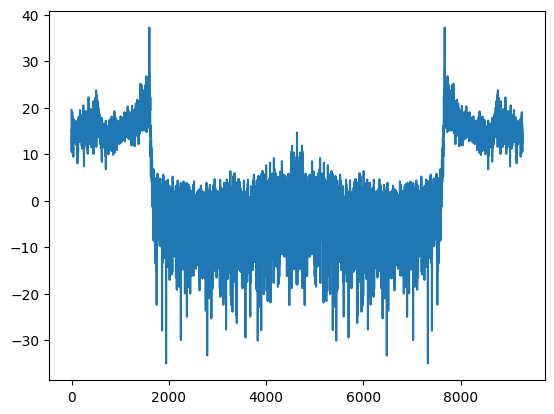

In [ ]:
x = x_speech[0:480000]
y = y_speech[:475000]
RunAnalysis(x, y, 10000, 20)

# Music

tamaño x:  (480815,)
tamaño y:  (480815,)
[1, 1, 3, 6, 11, 21, 39, 73, 135, 251, 464, 857, 1584, 2928, 5411, 10000]


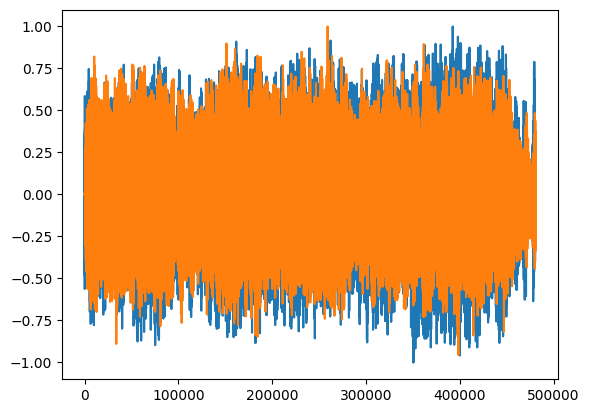

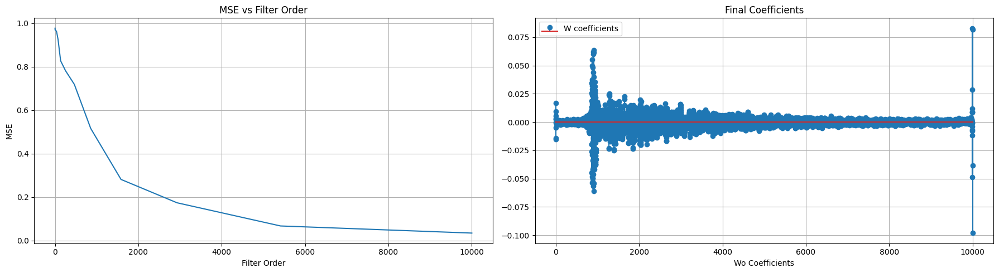

Minimum MSE:  0.034215231142018486  at M =  10000


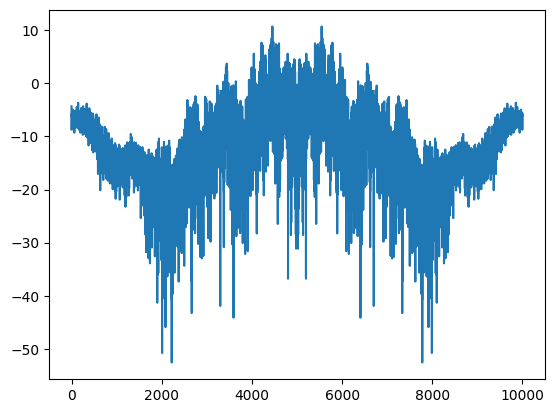

In [85]:
x = x_music
y = y_music
RunAnalysis(x, y, 10000, 15)

# Square Signal

tamaño x:  (480000,)
tamaño y:  (480815,)
[1, 1, 3, 5, 10, 19, 34, 62, 112, 202, 365, 660, 1191, 2149, 3879, 7000]


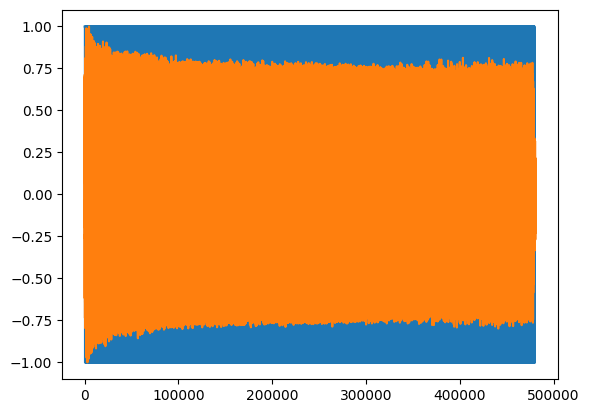

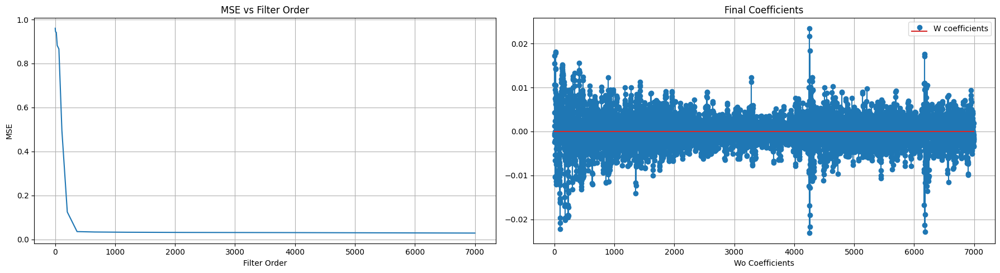

Minimum MSE:  0.02864115498960018  at M =  7000


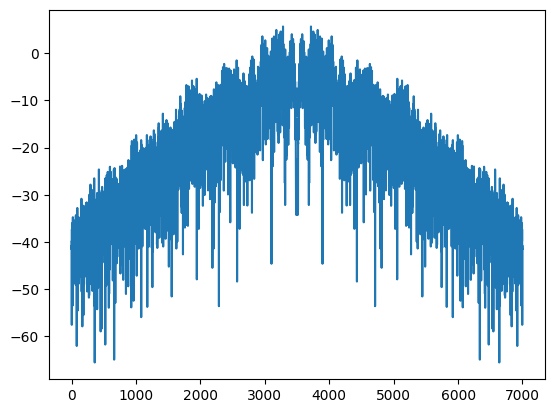

In [86]:
x = x_square
y = y_square
RunAnalysis(x, y, 7000, 15)